In [2]:
import pandas as pd
import numpy as np

file1 = pd.read_csv('data/msn_02_fuel_leak_signals_preprocessed.csv', sep=';')

In [3]:
file1.columns

Index(['UTC_TIME', 'MSN', 'Flight', 'ENGINE_RUNNING_1', 'ENGINE_RUNNING_2',
       'ENGINE_RUNNING_3', 'ENGINE_RUNNING_4', 'FLIGHT_PHASE_COUNT',
       'FUEL_FLOW_1', 'FUEL_FLOW_2',
       ...
       'STATE_FUEL_QTY_ACCURACY_LST_DEGRADED',
       'STATE_FUEL_QTY_ACCURACY_RST_DEGRADED',
       'STATUS_FUEL_QTY_PART_UNUSABLE_LST',
       'STATUS_FUEL_QTY_PART_UNUSABLE_RST', 'STATUS_FUEL_QTY_UNUSABLE_LST',
       'STATUS_FUEL_QTY_UNUSABLE_RST', 'STATUS_OVERFLOW_LST',
       'STATUS_OVERFLOW_RST', 'VALUE_FUEL_VOL_LST', 'VALUE_FUEL_VOL_RST'],
      dtype='object', length=111)

In [4]:
#only keeping the columns that are needed
file1 = file1[['UTC_TIME', 'MSN', 'Flight','FLIGHT_PHASE_COUNT','FUEL_USED_1','FUEL_USED_2', 'FUEL_USED_3', 'FUEL_USED_4', 'FW_GEO_ALTITUDE','VALUE_FOB', 'VALUE_FUEL_QTY_CC1',
       'VALUE_FUEL_QTY_CC2', 'VALUE_FUEL_QTY_CC3', 'VALUE_FUEL_QTY_CC4', 'VALUE_FUEL_QTY_CT', 'VALUE_FUEL_QTY_FT1', 'VALUE_FUEL_QTY_FT2', 
       'VALUE_FUEL_QTY_FT3', 'VALUE_FUEL_QTY_FT4', 'VALUE_FUEL_QTY_LXT', 'VALUE_FUEL_QTY_RXT']]

In [5]:
#create new column called total_fuel_used which is FUEL_USED_1 + FUEL_USED_2 + FUEL_USED_3 + FUEL_USED_4
file1['total_fuel_used'] = file1['FUEL_USED_1'] + file1['FUEL_USED_2'] + file1['FUEL_USED_3'] + file1['FUEL_USED_4']

file1['Fuel_On_board_tanks'] = file1['VALUE_FUEL_QTY_CC1'] + file1['VALUE_FUEL_QTY_CC2'] + file1['VALUE_FUEL_QTY_CC3'] + file1['VALUE_FUEL_QTY_CC4'] + file1['VALUE_FUEL_QTY_CT'] + file1['VALUE_FUEL_QTY_FT1'] + file1['VALUE_FUEL_QTY_FT2'] + file1['VALUE_FUEL_QTY_FT3'] + file1['VALUE_FUEL_QTY_FT4'] + file1['VALUE_FUEL_QTY_LXT'] + file1['VALUE_FUEL_QTY_RXT']

#plot (FOB - total_fuel_used) and Fuel_On_board_tanks for each flight
file1['FOB - total_fuel_used'] = file1['VALUE_FOB'] - file1['total_fuel_used']

#calculate 2 columns called fuel_used_per_minute_FOB and fuel_used_per_minute_total_fuel_used
file1['fuel_used_per_minute_FOB_diff'] = file1['VALUE_FOB'].diff()
file1['fuel_used_per_minute_total_fuel_used_diff'] = file1['total_fuel_used'].diff()

In [6]:
file1.head()

,UTC_TIME,MSN,Flight,FLIGHT_PHASE_COUNT,FUEL_USED_1,FUEL_USED_2,FUEL_USED_3,FUEL_USED_4,FW_GEO_ALTITUDE,VALUE_FOB,...,VALUE_FUEL_QTY_FT2,VALUE_FUEL_QTY_FT3,VALUE_FUEL_QTY_FT4,VALUE_FUEL_QTY_LXT,VALUE_FUEL_QTY_RXT,total_fuel_used,Fuel_On_board_tanks,FOB - total_fuel_used,fuel_used_per_minute_FOB_diff,fuel_used_per_minute_total_fuel_used_diff
0,2011-03-09 12:06:01,A400M-0002,V0136,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2011-03-09 12:06:02,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.000,26988.0,...,2509.0,2591.0,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,NaN,NaN
2,2011-03-09 12:06:03,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,271.625,26988.0,...,2509.0,2591.0,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0
3,2011-03-09 12:06:04,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.000,26988.0,...,2509.0,2591.0,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0
4,2011-03-09 12:06:05,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.125,26988.0,...,2509.0,2591.0,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0


In [7]:
file1.isna().sum()

UTC_TIME                                          0
MSN                                               0
Flight                                            0
FLIGHT_PHASE_COUNT                            62922
FUEL_USED_1                                  108636
FUEL_USED_2                                  106980
FUEL_USED_3                                  106979
FUEL_USED_4                                  108867
FW_GEO_ALTITUDE                               62875
VALUE_FOB                                     63258
VALUE_FUEL_QTY_CC1                            63293
VALUE_FUEL_QTY_CC2                            63293
VALUE_FUEL_QTY_CC3                            63293
VALUE_FUEL_QTY_CC4                            63293
VALUE_FUEL_QTY_CT                             62976
VALUE_FUEL_QTY_FT1                            62970
VALUE_FUEL_QTY_FT2                            62971
VALUE_FUEL_QTY_FT3                            62970
VALUE_FUEL_QTY_FT4                            62973
VALUE_FUEL_Q

In [8]:
file1.dropna(inplace=True)

In [9]:
#creating a column called cummalitive_fuel_used which is the cummulative sum of total_fuel_used
file1['cummalitive_fuel_used'] = file1['total_fuel_used'].cumsum()


In [10]:
#creating a new column that is called initial_FOB which is the first value of VALUE_FOB for each flight
file1['initial_FOB'] = file1.groupby('Flight')['VALUE_FOB'].transform('first')

In [11]:
file1.head()

,UTC_TIME,MSN,Flight,FLIGHT_PHASE_COUNT,FUEL_USED_1,FUEL_USED_2,FUEL_USED_3,FUEL_USED_4,FW_GEO_ALTITUDE,VALUE_FOB,...,VALUE_FUEL_QTY_FT4,VALUE_FUEL_QTY_LXT,VALUE_FUEL_QTY_RXT,total_fuel_used,Fuel_On_board_tanks,FOB - total_fuel_used,fuel_used_per_minute_FOB_diff,fuel_used_per_minute_total_fuel_used_diff,cummalitive_fuel_used,initial_FOB
2,2011-03-09 12:06:03,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,271.625,26988.0,...,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0,0.0,26988.0
3,2011-03-09 12:06:04,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.000,26988.0,...,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0,0.0,26988.0
4,2011-03-09 12:06:05,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.125,26988.0,...,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0,0.0,26988.0
5,2011-03-09 12:06:06,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.125,26988.0,...,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0,0.0,26988.0
6,2011-03-09 12:06:07,A400M-0002,V0136,1.0,0.0,0.0,0.0,0.0,272.125,26988.0,...,1966.0,8951.0,8999.0,0.0,28232.0,26988.0,0.0,0.0,0.0,26988.0


<Axes: >

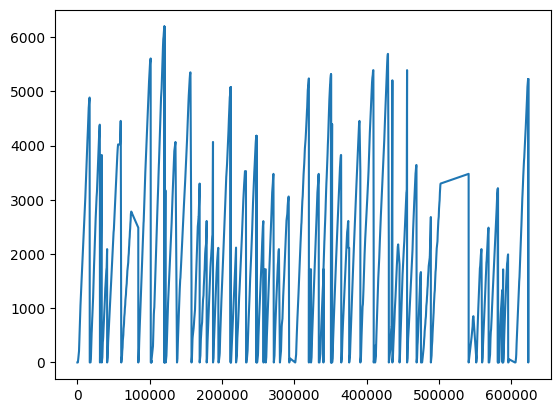

In [12]:
file1['FUEL_USED_1'].plot()

In [13]:
#new column called fuel_used+FOB which is the sum of total_fuel_used and VALUE_FOB
file1['fuel_used+FOB'] = file1['total_fuel_used'] + file1['VALUE_FOB']

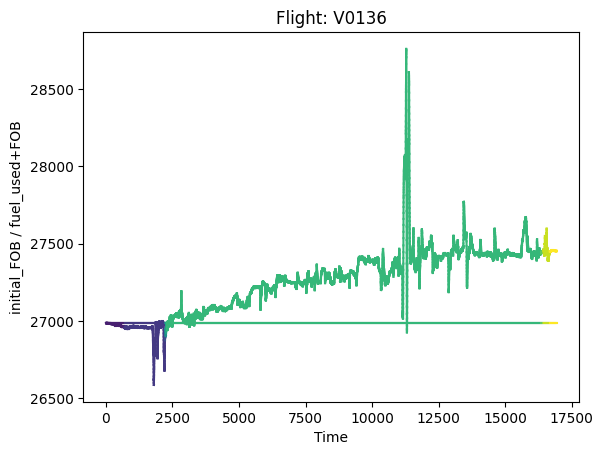

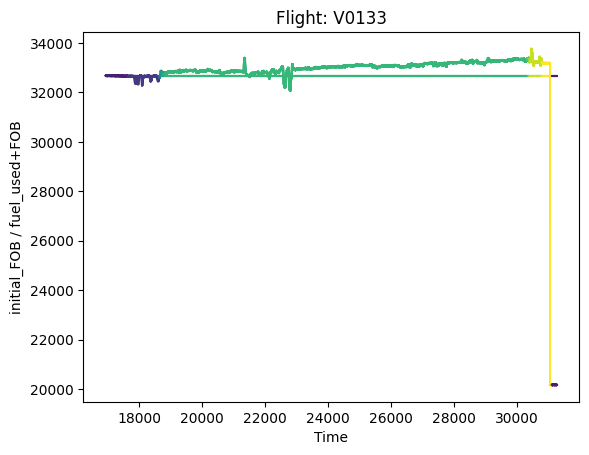

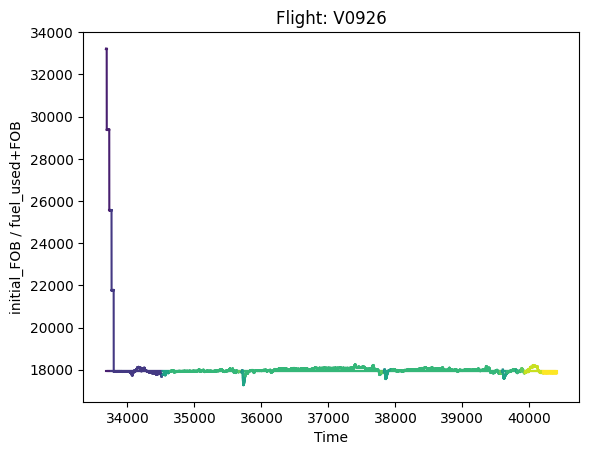

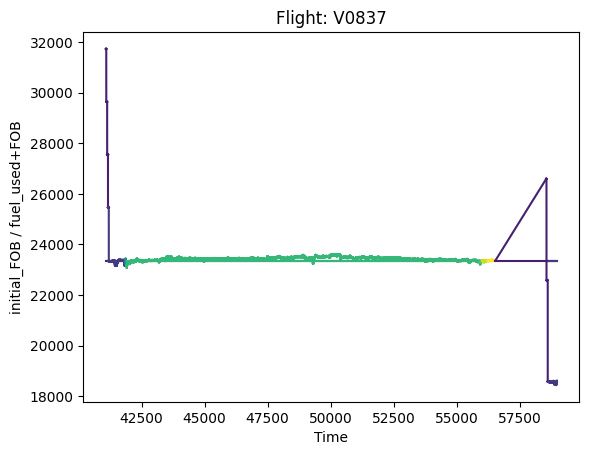

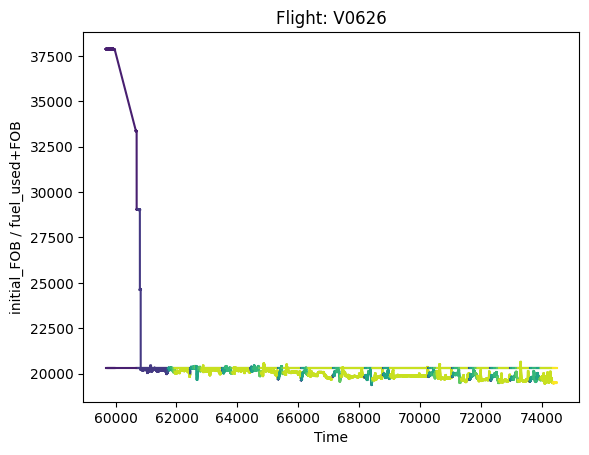

...

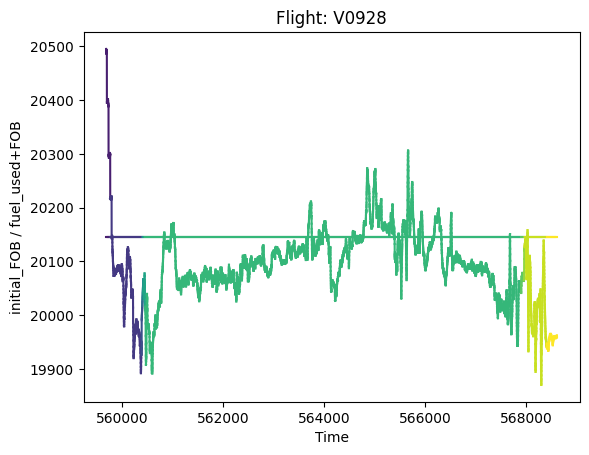

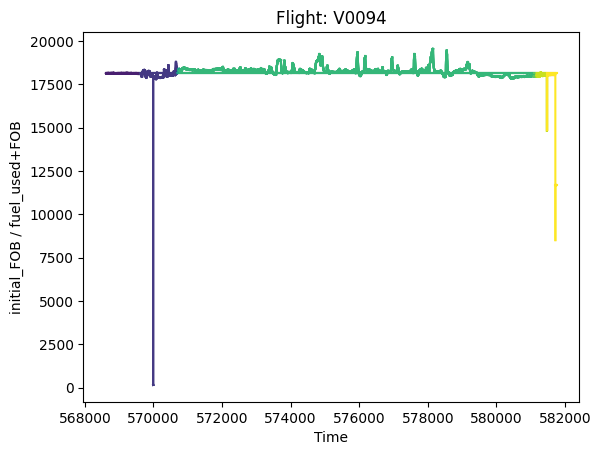

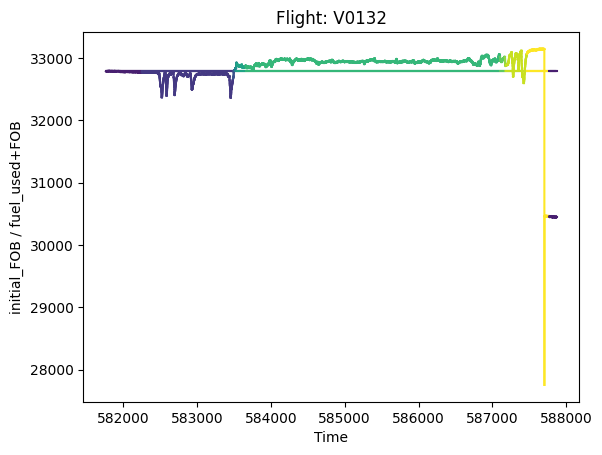

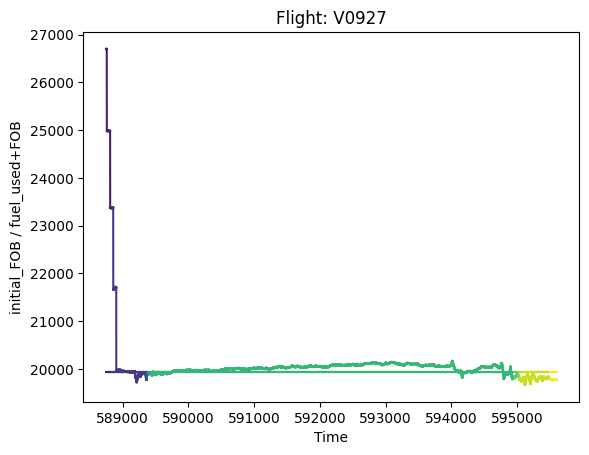

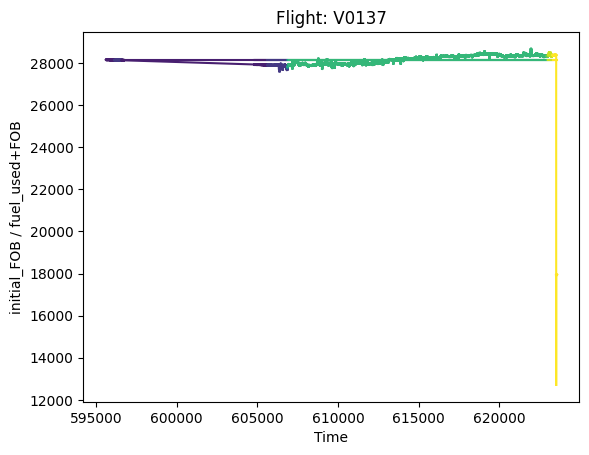

In [14]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique flights
unique_flights = file1['Flight'].unique()

# For each unique flight
for flight in unique_flights:
    # Filter data for that flight
    flight_data = file1[file1['Flight'] == flight]
    
    # Create a new figure
    plt.figure()
    
    # For each row in the flight data
    for i in range(1, len(flight_data)):
        # Plot a line segment from the current row to the next row for 'initial_FOB'
        plt.plot(flight_data.index[i-1:i+1], flight_data['initial_FOB'].iloc[i-1:i+1], color=plt.cm.viridis(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]/flight_data['FLIGHT_PHASE_COUNT'].max()))
        
        # Plot a line segment from the current row to the next row for 'fuel_used+FOB'
        plt.plot(flight_data.index[i-1:i+1], flight_data['fuel_used+FOB'].iloc[i-1:i+1], color=plt.cm.viridis(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]/flight_data['FLIGHT_PHASE_COUNT'].max()))
    
    # Set the title to the flight number
    plt.title(f'Flight: {flight}')
    plt.xlabel('Time')
    plt.ylabel('initial_FOB / fuel_used+FOB')
    plt.show()  # Show the plot


In [15]:
file6 = pd.read_csv('data/msn_29_fuel_leak_signals_preprocessed.csv', sep=';')

In [16]:
file6.head()

,UTC_TIME,FUEL_USED_2,FUEL_USED_3,FUEL_USED_4,FW_GEO_ALTITUDE,VALUE_FOB,VALUE_FUEL_QTY_CT,VALUE_FUEL_QTY_FT1,VALUE_FUEL_QTY_FT2,VALUE_FUEL_QTY_FT3,VALUE_FUEL_QTY_FT4,VALUE_FUEL_QTY_LXT,VALUE_FUEL_QTY_RXT,FLIGHT_PHASE_COUNT,FUEL_USED_1,Flight,MSN
0,2014-07-24 07:04:35,682.630615,663.887573,641.243591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.553467,0.0,F-RBAC
1,2014-07-24 07:04:36,682.630615,663.887573,641.243591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.553467,0.0,F-RBAC
2,2014-07-24 07:04:37,682.630615,663.887573,641.243591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.553467,0.0,F-RBAC
3,2014-07-24 07:04:38,682.630615,663.887573,641.243591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.553467,0.0,F-RBAC
4,2014-07-24 07:04:39,682.630615,663.887573,641.243591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.553467,0.0,F-RBAC


In [17]:
#create new column called total_fuel_used which is FUEL_USED_1 + FUEL_USED_2 + FUEL_USED_3 + FUEL_USED_4
file6['total_fuel_used'] = file6['FUEL_USED_1'] + file6['FUEL_USED_2'] + file6['FUEL_USED_3'] + file6['FUEL_USED_4']

file6['Fuel_On_board_tanks'] = file6['VALUE_FUEL_QTY_CT'] + file6['VALUE_FUEL_QTY_FT1'] + file6['VALUE_FUEL_QTY_FT2'] + file6['VALUE_FUEL_QTY_FT3'] + file6['VALUE_FUEL_QTY_FT4'] + file6['VALUE_FUEL_QTY_LXT'] + file6['VALUE_FUEL_QTY_RXT']

#plot (FOB - total_fuel_used) and Fuel_On_board_tanks for each flight
file6['FOB - total_fuel_used'] = file6['VALUE_FOB'] - file6['total_fuel_used']

#calculate 2 columns called fuel_used_per_minute_FOB and fuel_used_per_minute_total_fuel_used
file6['fuel_used_per_minute_FOB_diff'] = file6['VALUE_FOB'].diff()
file6['fuel_used_per_minute_total_fuel_used_diff'] = file6['total_fuel_used'].diff()

In [18]:
file6.dropna(inplace=True)

In [19]:
file6.shape

(49926, 22)

In [20]:
#creating a column called cummalitive_fuel_used which is the cummulative sum of total_fuel_used
file6['cummalitive_fuel_used'] = file6['total_fuel_used'].cumsum()

In [21]:
#creating a new column that is called initial_FOB which is the first value of VALUE_FOB for each flight
file6['initial_FOB'] = file6.groupby('Flight')['VALUE_FOB'].transform('first')

In [22]:
#new column called fuel_used+FOB which is the sum of total_fuel_used and VALUE_FOB
file6['fuel_used+FOB'] = file6['total_fuel_used'] + file6['VALUE_FOB']

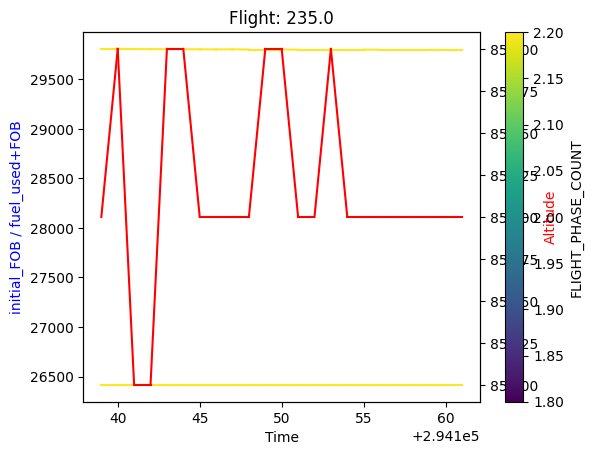

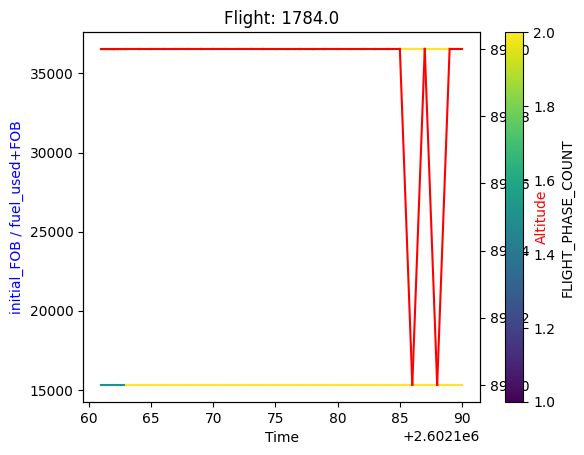

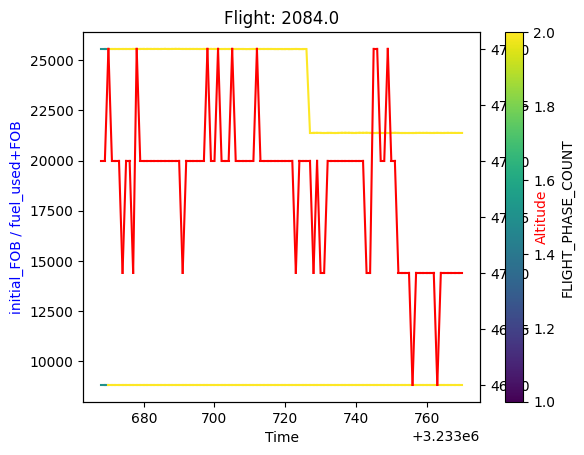

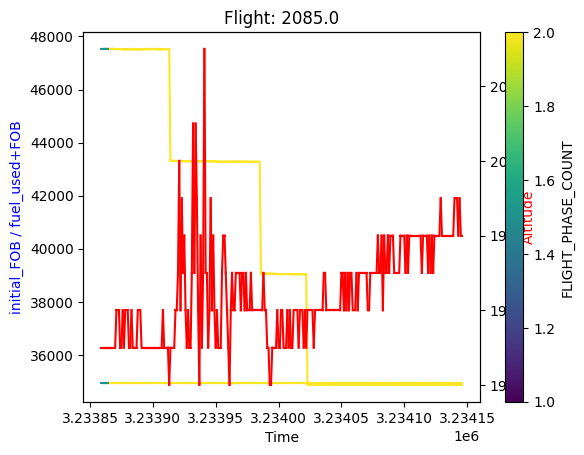

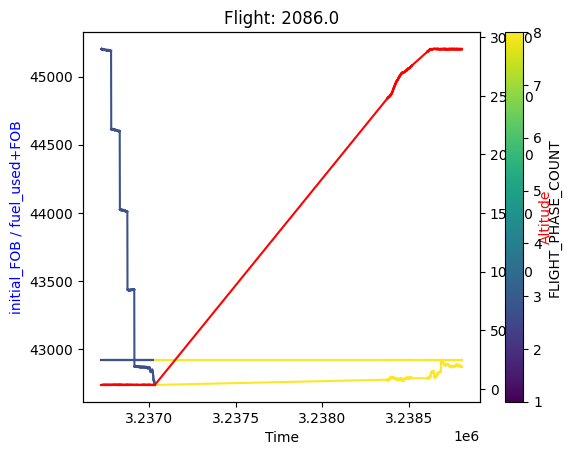

...

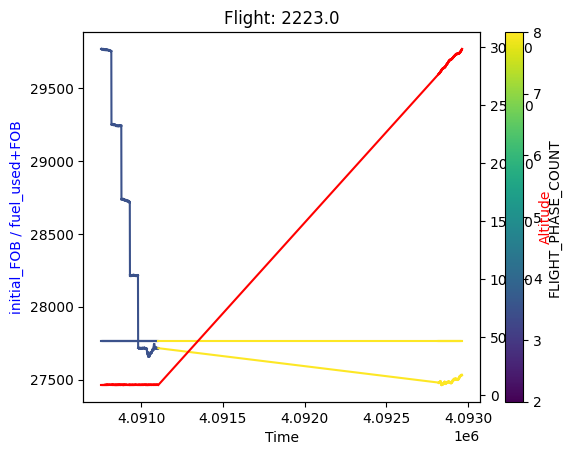

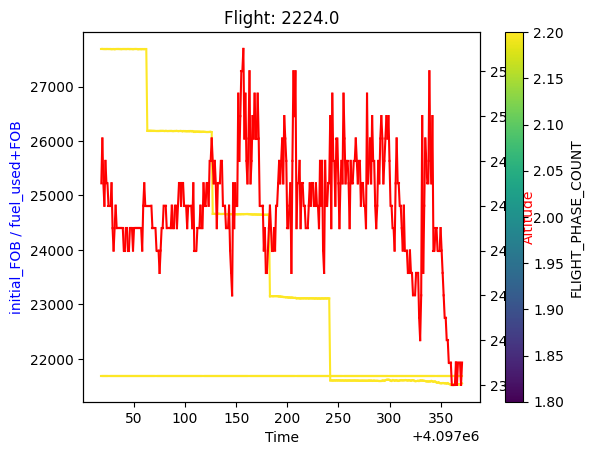

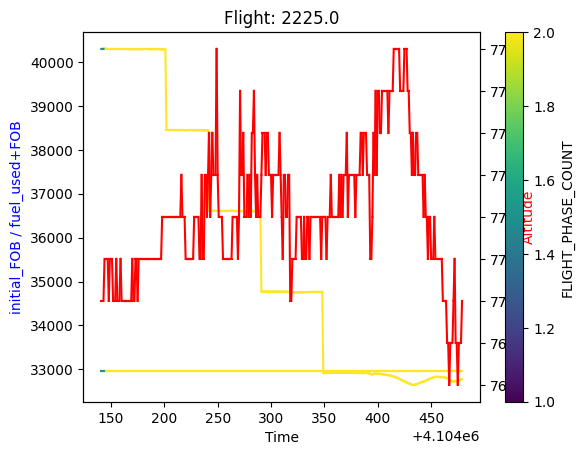

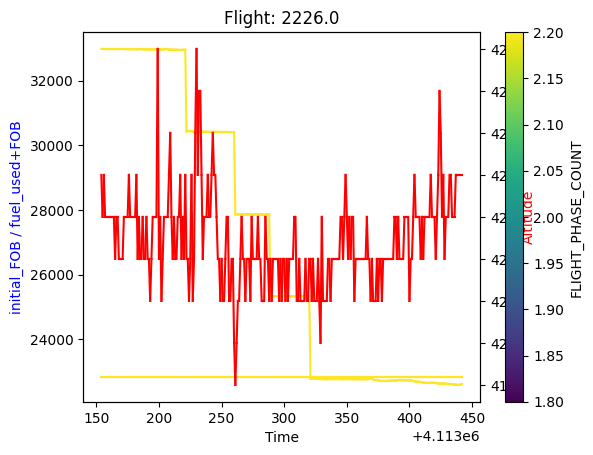

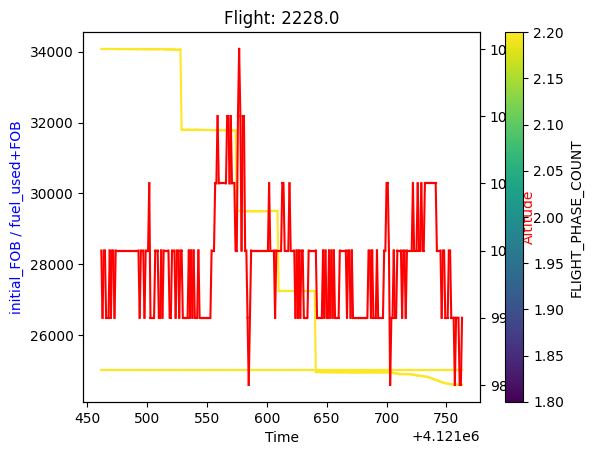

In [23]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique flights
unique_flights = file6['Flight'].unique()

# For each unique flight
for flight in unique_flights:
    # Filter data for that flight
    flight_data = file6[file6['Flight'] == flight]
    
    # Create a new figure and add a second y-axis
    fig, ax1 = plt.subplots()
    ax2 = ax1.twinx()
    
    # Create a ScalarMappable object for the colorbar
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=flight_data['FLIGHT_PHASE_COUNT'].min(), vmax=flight_data['FLIGHT_PHASE_COUNT'].max()))
    sm.set_array([])
    
    # For each row in the flight data
    for i in range(1, len(flight_data)):
        # Plot a line segment from the current row to the next row for 'initial_FOB'
        ax1.plot(flight_data.index[i-1:i+1], flight_data['initial_FOB'].iloc[i-1:i+1], color=plt.cm.viridis(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]/flight_data['FLIGHT_PHASE_COUNT'].max()))
        
        # Plot a line segment from the current row to the next row for 'fuel_used+FOB'
        ax1.plot(flight_data.index[i-1:i+1], flight_data['fuel_used+FOB'].iloc[i-1:i+1], color=plt.cm.viridis(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]/flight_data['FLIGHT_PHASE_COUNT'].max()))
        
        # Plot a line segment from the current row to the next row for 'Altitude' on the second y-axis
        ax2.plot(flight_data.index[i-1:i+1], flight_data['FW_GEO_ALTITUDE'].iloc[i-1:i+1], color='red')
    
    # Set the title to the flight number
    plt.title(f'Flight: {flight}')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('initial_FOB / fuel_used+FOB', color='blue')
    ax2.set_ylabel('Altitude', color='red')
    
    # Add the colorbar to the figure
    fig.colorbar(sm, ax=ax1, orientation='vertical', label='FLIGHT_PHASE_COUNT')
    
    plt.show()  # Show the plot

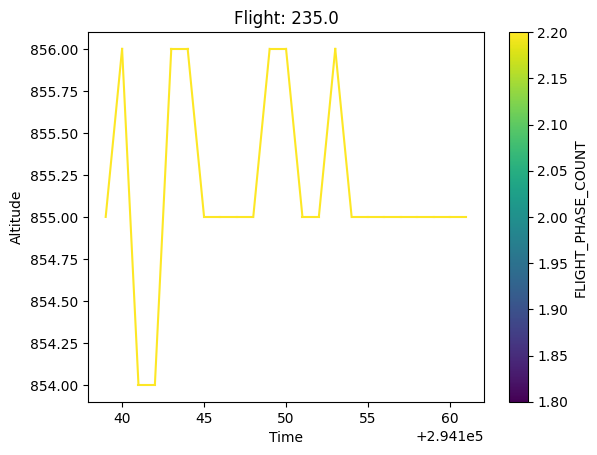

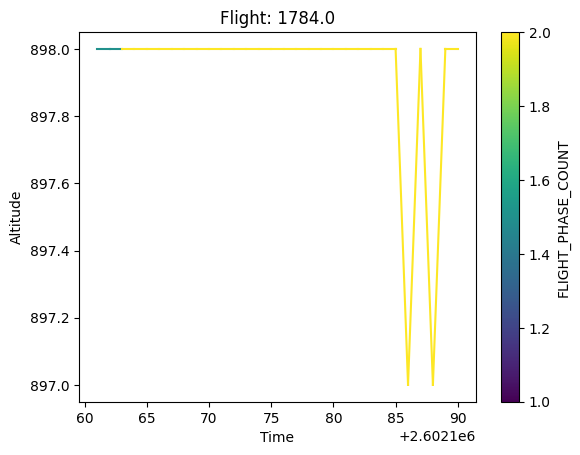

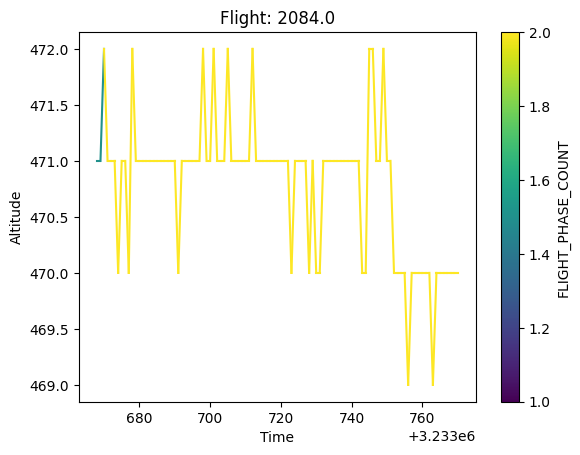

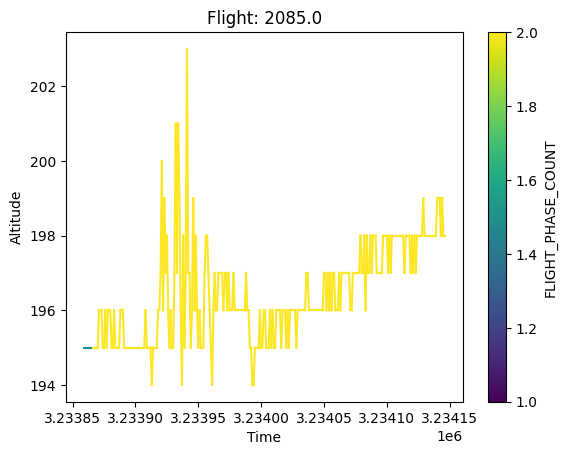

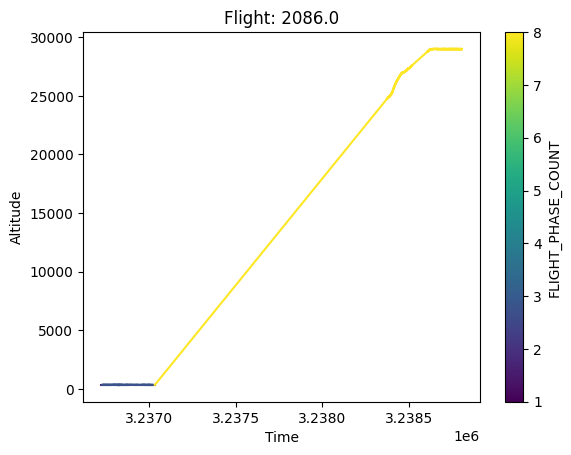

...

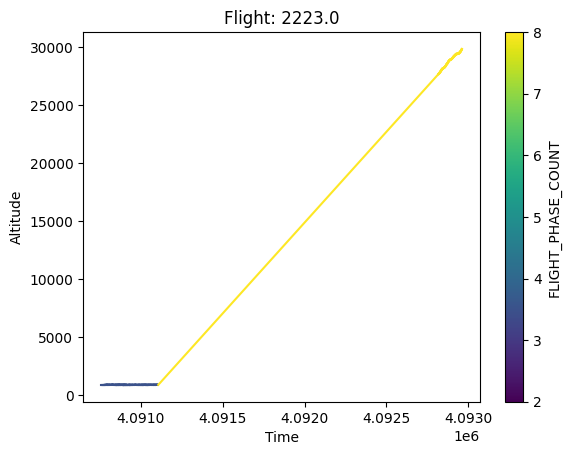

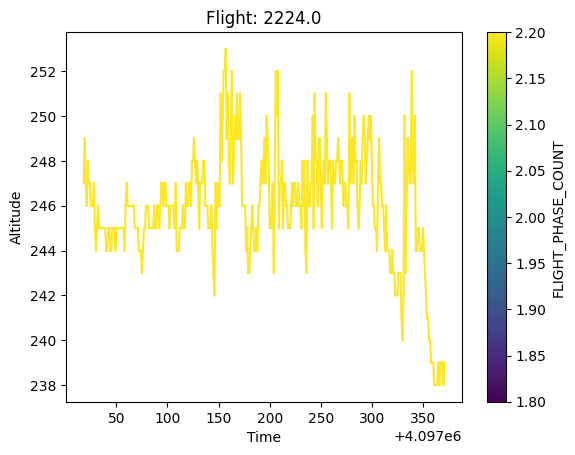

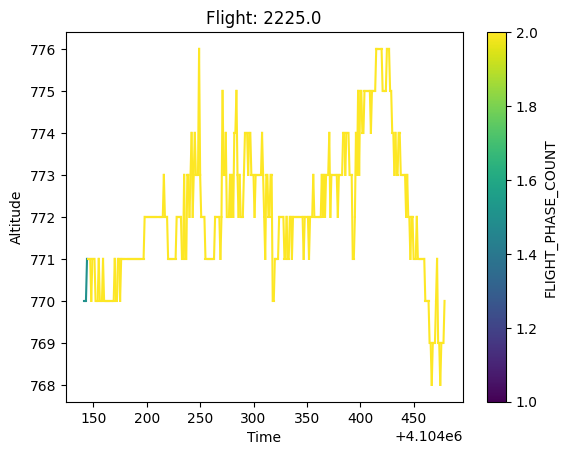

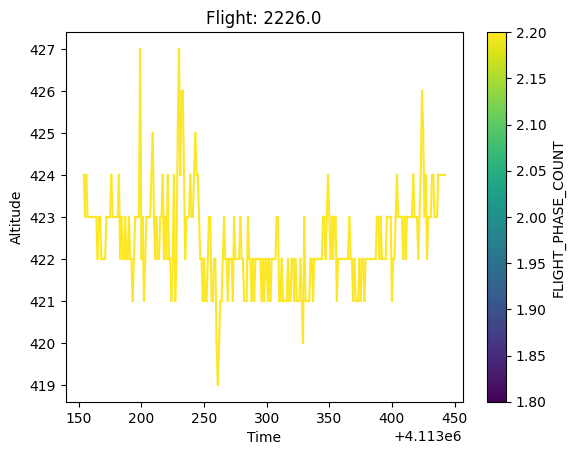

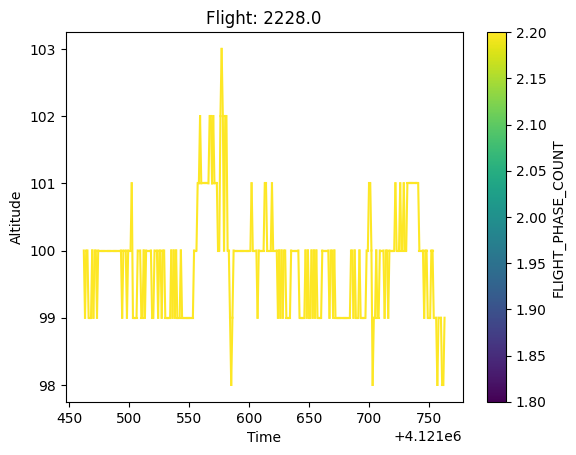

In [24]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique flights
unique_flights = file6['Flight'].unique()

# For each unique flight
for flight in unique_flights:
    # Filter data for that flight
    flight_data = file6[file6['Flight'] == flight]
    
    # Create a new figure
    fig, ax = plt.subplots()
    
    # For each row in the flight data
    for i in range(1, len(flight_data)):
        # Plot a line segment from the current row to the next row for 'Altitude'
        sc = ax.plot(flight_data.index[i-1:i+1], flight_data['FW_GEO_ALTITUDE'].iloc[i-1:i+1], color=plt.cm.viridis(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]/flight_data['FLIGHT_PHASE_COUNT'].max()))
    
    # Set the title to the flight number
    ax.set_title(f'Flight: {flight}')
    ax.set_xlabel('Time')
    ax.set_ylabel('Altitude')
    
    # Create a colorbar
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=flight_data['FLIGHT_PHASE_COUNT'].min(), vmax=flight_data['FLIGHT_PHASE_COUNT'].max()))
    sm.set_array([])
    fig.colorbar(sm, ax=ax, orientation='vertical', label='FLIGHT_PHASE_COUNT')
    
    plt.show()  # Show the plot

In [25]:
file6['diff_initial_FOB_fuel_used+FOB'] = file6['initial_FOB'] - file6['fuel_used+FOB']


/var/folders/6g/x5lm6rt15m9bd1llv55ld0_h0000gn/T/ipykernel_17842/1303876841.py:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', 8)


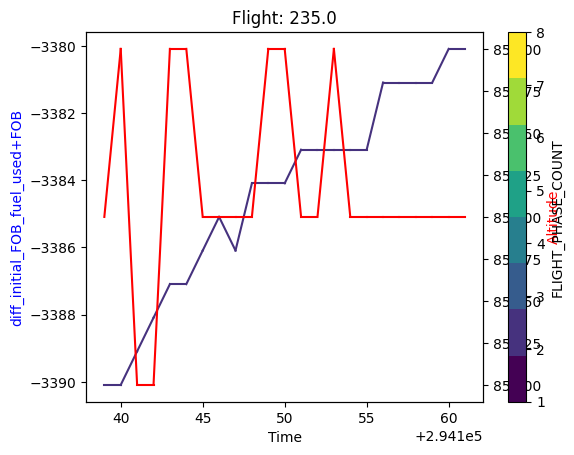

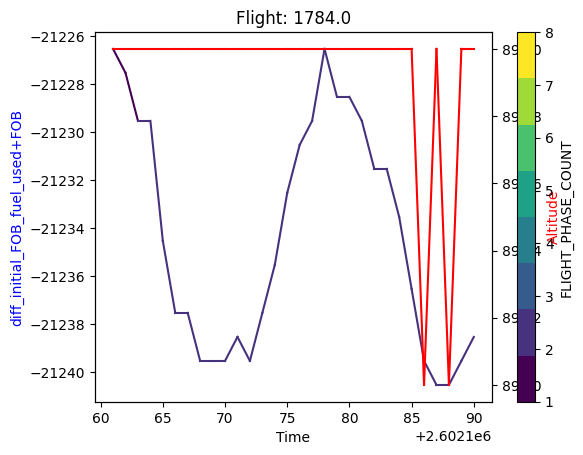

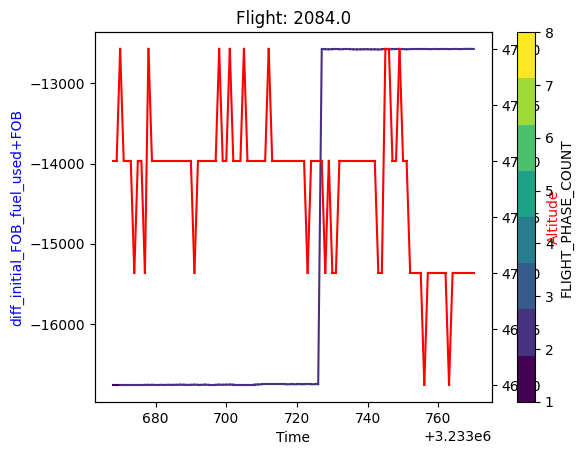

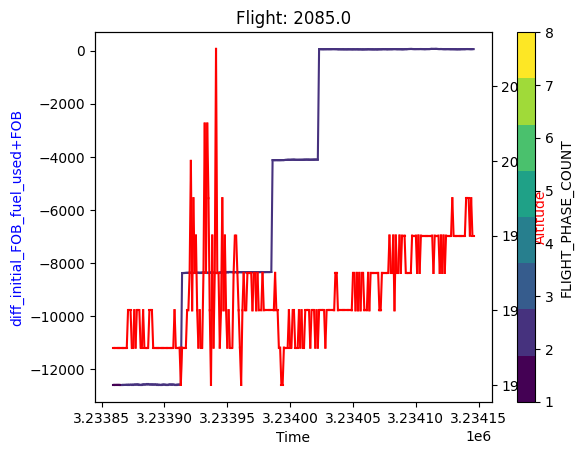

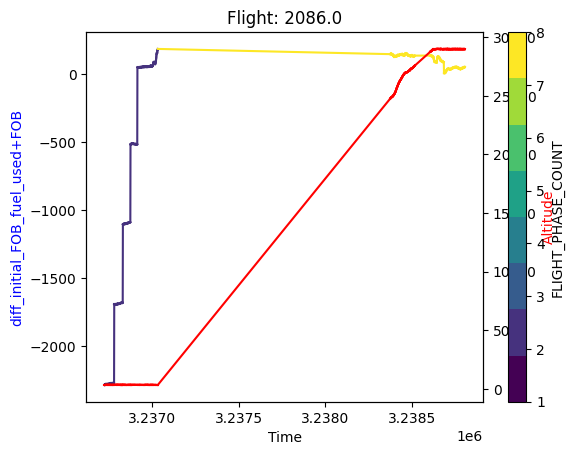

...

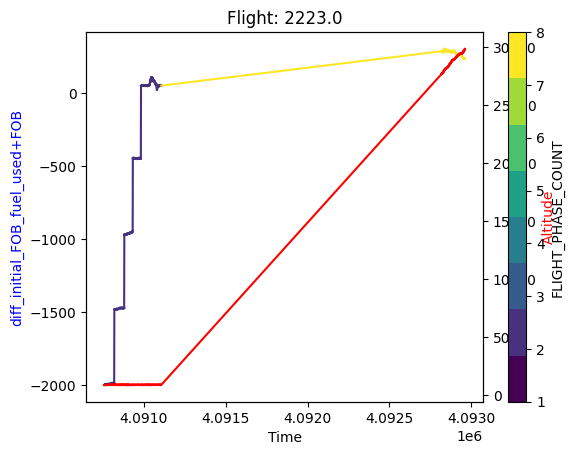

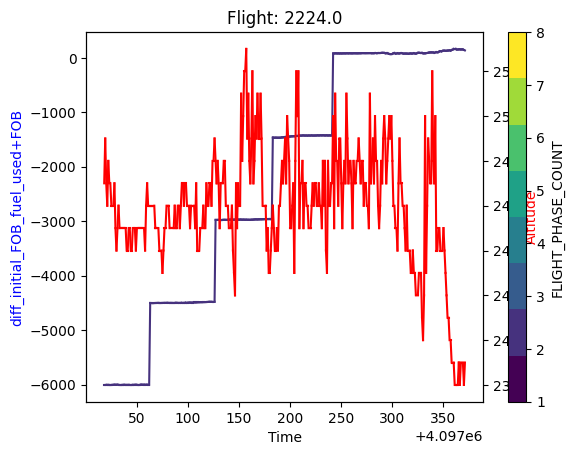

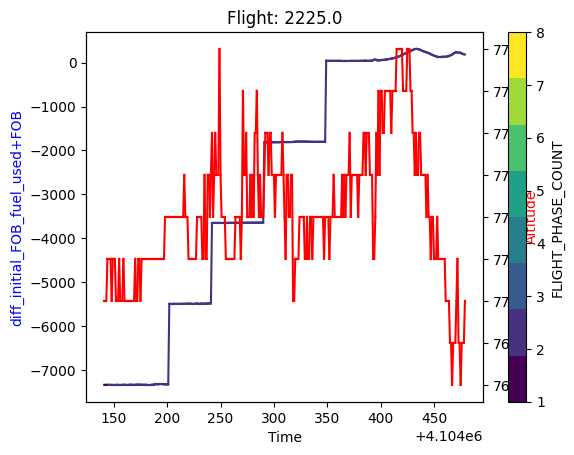

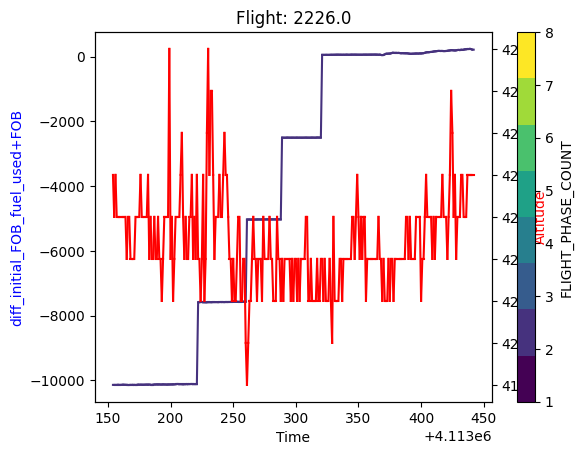

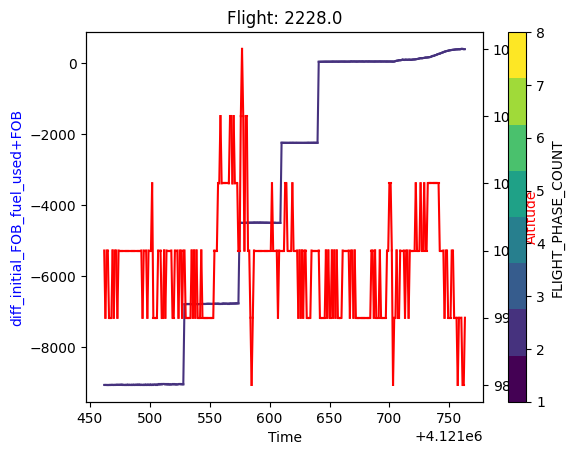

In [26]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique flights
unique_flights = file6['Flight'].unique()

# Define a colormap with a fixed range for flight phases (assuming phases range from 1 to 8)
cmap = plt.cm.get_cmap('viridis', 8)
norm = plt.Normalize(vmin=1, vmax=8)

# For each unique flight
for flight in unique_flights:
    # Filter data for that flight
    flight_data = file6[file6['Flight'] == flight]
    
    # Create a new figure and add a second y-axis
    fig, ax1 = plt.subplots()
    ax2 = ax1.twinx()
    
    # For each row in the flight data
    for i in range(1, len(flight_data)):
        # Plot a line segment from the current row to the next row for 'diff_initial_FOB_fuel_used+FOB'
        color = cmap(norm(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]))
        ax1.plot(flight_data.index[i-1:i+1], flight_data['diff_initial_FOB_fuel_used+FOB'].iloc[i-1:i+1], color=color)
        
        # Plot a line segment from the current row to the next row for 'Altitude' on the second y-axis
        ax2.plot(flight_data.index[i-1:i+1], flight_data['FW_GEO_ALTITUDE'].iloc[i-1:i+1], color='red')
    
    # Set the title to the flight number
    plt.title(f'Flight: {flight}')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('diff_initial_FOB_fuel_used+FOB', color='blue')
    ax2.set_ylabel('Altitude', color='red')
    
    # Add the colorbar to the figure
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    fig.colorbar(sm, ax=ax1, orientation='vertical', label='FLIGHT_PHASE_COUNT')
    
    plt.show()  # Show the plot


/var/folders/6g/x5lm6rt15m9bd1llv55ld0_h0000gn/T/ipykernel_17842/1303876841.py:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', 8)


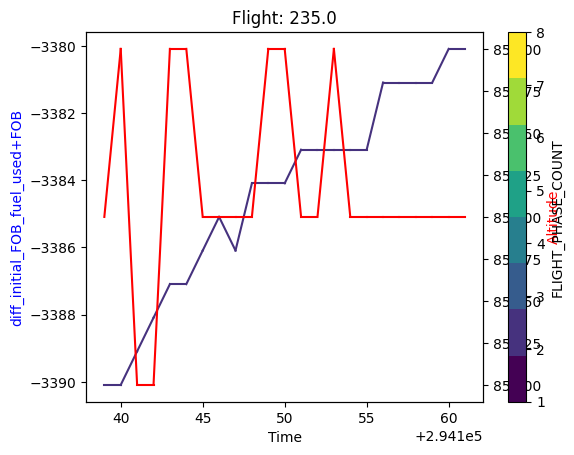

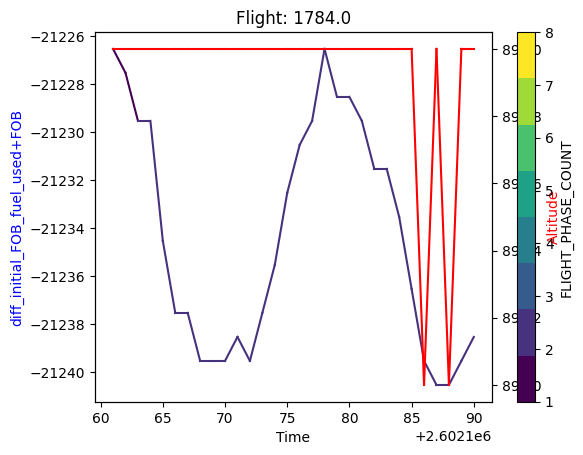

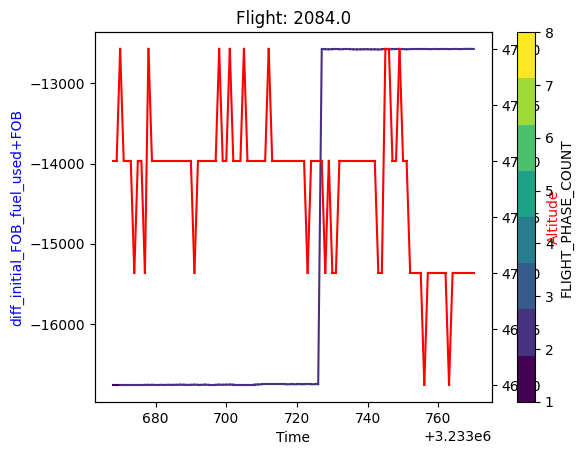

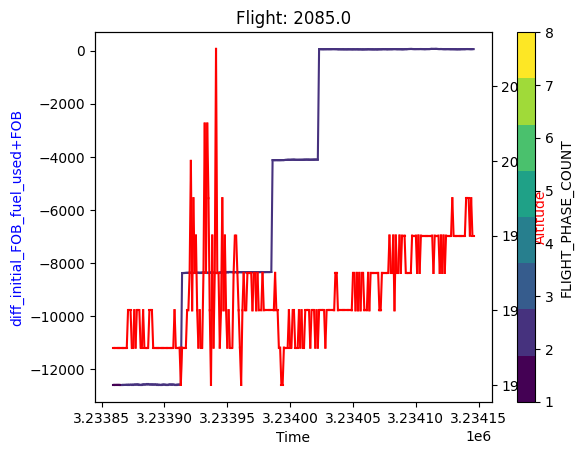

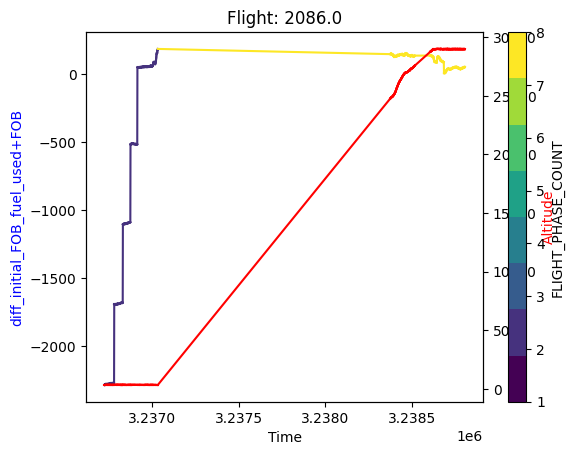

...

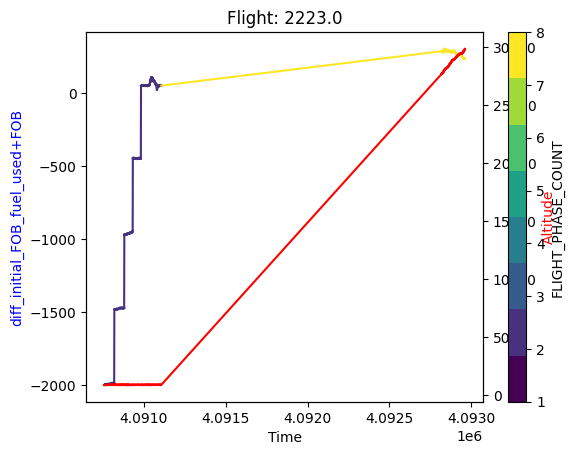

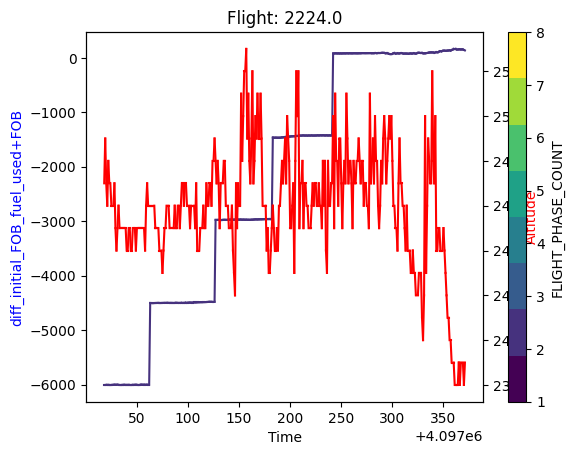

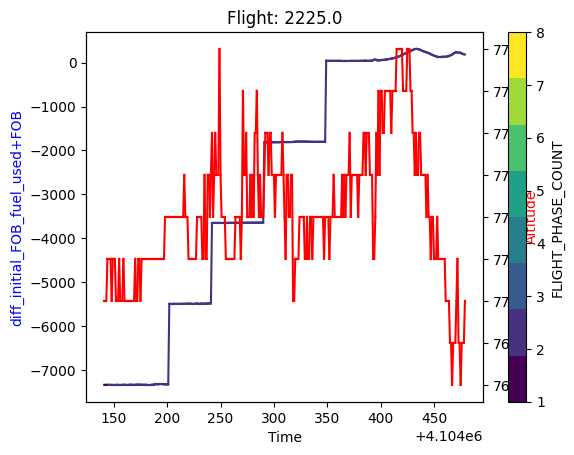

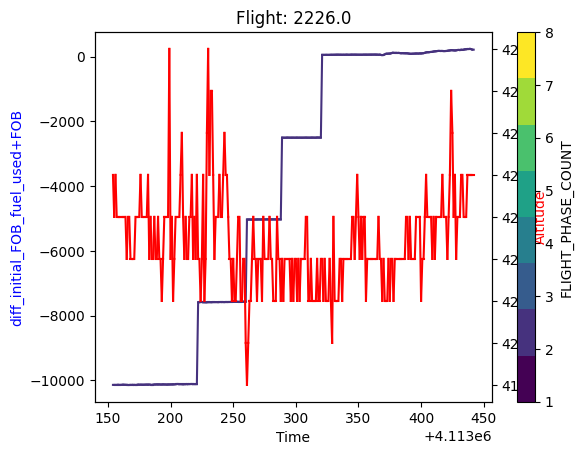

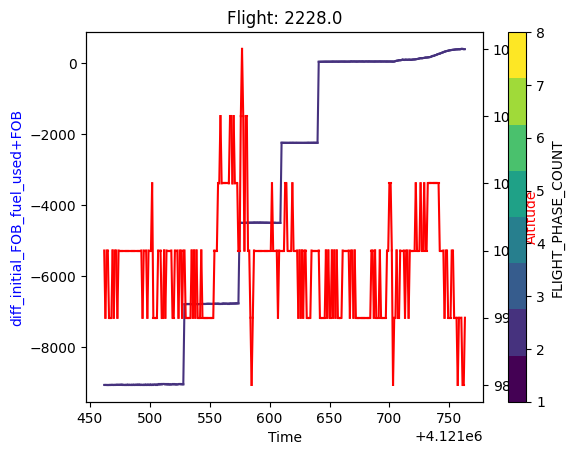

In [27]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique flights
unique_flights = file6['Flight'].unique()

# Define a colormap with a fixed range for flight phases (assuming phases range from 1 to 8)
cmap = plt.cm.get_cmap('viridis', 8)
norm = plt.Normalize(vmin=1, vmax=8)

# For each unique flight
for flight in unique_flights:
    # Filter data for that flight
    flight_data = file6[file6['Flight'] == flight]
    
    # Create a new figure and add a second y-axis
    fig, ax1 = plt.subplots()
    ax2 = ax1.twinx()
    
    # For each row in the flight data
    for i in range(1, len(flight_data)):
        # Plot a line segment from the current row to the next row for 'diff_initial_FOB_fuel_used+FOB'
        color = cmap(norm(flight_data['FLIGHT_PHASE_COUNT'].iloc[i]))
        ax1.plot(flight_data.index[i-1:i+1], flight_data['diff_initial_FOB_fuel_used+FOB'].iloc[i-1:i+1], color=color)
        
        # Plot a line segment from the current row to the next row for 'Altitude' on the second y-axis
        ax2.plot(flight_data.index[i-1:i+1], flight_data['FW_GEO_ALTITUDE'].iloc[i-1:i+1], color='red')
    
    # Set the title to the flight number
    plt.title(f'Flight: {flight}')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('diff_initial_FOB_fuel_used+FOB', color='blue')
    ax2.set_ylabel('Altitude', color='red')
    
    # Add the colorbar to the figure
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    fig.colorbar(sm, ax=ax1, orientation='vertical', label='FLIGHT_PHASE_COUNT')
    
    plt.show()  # Show the plot


In [28]:
#calculating the average diff_initial_FOB_fuel_used+FOB for each flight phase
file6.groupby('FLIGHT_PHASE_COUNT')['diff_initial_FOB_fuel_used+FOB'].mean()

FLIGHT_PHASE_COUNT
1.0    -9874.759557
2.0    -4225.314128
6.0      113.933612
7.0      189.576688
8.0      122.795408
11.0     108.727319
12.0      12.171692
Name: diff_initial_FOB_fuel_used+FOB, dtype: float64

In [29]:
file6['alititude_diff'] = file6['FW_GEO_ALTITUDE'].diff()

In [30]:
file6.groupby('FLIGHT_PHASE_COUNT')['alititude_diff'].mean()

FLIGHT_PHASE_COUNT
1.0    -899.255278
2.0      -5.247633
6.0      42.750000
7.0      65.961240
8.0      72.598331
11.0   -116.238959
12.0     -2.000000
Name: alititude_diff, dtype: float64

In [31]:
file6.groupby('FLIGHT_PHASE_COUNT')['alititude_diff'].count()

FLIGHT_PHASE_COUNT
1.0       521
2.0     36974
6.0         8
7.0       129
8.0     11024
11.0     1268
12.0        1
Name: alititude_diff, dtype: int64